In [2]:
cd ..

/home/msi/projects/diplomka


In [3]:
import scipy.stats as st
from pprint import pprint

import glob
import os 
import numpy as np
import pandas as pd
from tqdm import tqdm

from scipy.stats import hmean
from collections import defaultdict

from traced.trace_monitor import SiteTraceMonitor, MultiSiteTraceMonitor
from traced.models import NormalModel

import matplotlib.pyplot as plt 

In [4]:
import plotly.graph_objects as go

In [5]:
import plotly.express as px
import plotly.io as pio

pio.renderers.default = "plotly_mimetype+notebook"

In [6]:
import plotly
plotly.offline.init_notebook_mode()

In [7]:
dataset = os.listdir('data/sites/')[2]
dataset

'INFN-T1'

In [8]:
files = sorted(glob.glob(f"data/sites/{dataset}/*"))

In [9]:
src_site, dest_site = dataset.split('-')

In [24]:
src_sites = {}

In [25]:
import json

In [26]:
for file in tqdm(files, total=len(files)):
    with open(file, 'r') as f:
        data = json.load(f)
    site = data.get('src_site', 'NA') 
    if site not in src_sites:
        src_sites[site] = set()
    src_sites[site].add(file)

100%|██████████| 3246463/3246463 [08:31<00:00, 6341.47it/s]


In [22]:
data

{'max_rtt': 43.2,
 'src_VO': 'ATLAS',
 'created_at': '2023-04-01T00:06:22.187091958Z',
 'dest': '2001:760:4205:254::12',
 'src_site': 'DESY-ZN',
 'path_complete': False,
 'MA': '2001:638:700:f0c8::1:1d',
 'destination_reached': True,
 'ipv6': True,
 'dest_production': True,
 'asns': [680, 680, 680, 680, 20965, 20965, 20965, 20965, 137, 137],
 'n_hops': 10,
 'timestamp': 1680307201000,
 'src': '2001:638:700:f0c8::1:1d',
 'dest_site': 'INFN-T1',
 'dest_VO': 'ATLAS',
 'looping': False,
 'src_host': 'perfson2.zeuthen.desy.de',
 'push': False,
 'route-sha1': '7e8b28f5217c2cf9930b27605f4d5372a51f3116',
 'ttls': [1, 2, 3, 4, 6, 7, 8, 9, 12, 16],
 'rtts': [0.8,
  0.3,
  0.7,
  8.200000000000001,
  16.9,
  34.0,
  31.6,
  38.0,
  43.2,
  41.7],
 'dest_host': 'perfsonar-ow.cnaf.infn.it',
 'hops': ['2001:638:700:f0c8::3',
  '2001:638:700:f000::44',
  '2001:638:700:f000::32',
  '2001:638:700:f000::27',
  '2001:798:111:1::35',
  '2001:798:cc:1::25',
  '2001:798:111:1::61',
  '2001:798:111:1::1e',
 

In [36]:
site_iter = iter(sorted([(len(v), k) for k,v in src_sites.items()], key=lambda x: x[0], reverse=True))

In [43]:
stm = MultiSiteTraceMonitor()

In [37]:
site = next(site_iter)

In [44]:
stm.process(sorted(src_sites[site[1]]))

100%|██████████| 139518/139518 [01:45<00:00, 1323.56it/s]


In [226]:
rtt_dfs = {}
ttl_dfs = {}
rtt_ipv4 = {}
rtt_ipv6 = {}

ttl_ipv4 = {}
ttl_ipv6 = {}

In [48]:
# sites = list(stm.trace_models.keys())[32]
sites = site[1], 'INFN-T1'

In [49]:
src_site, dest_site = sites

In [316]:
ip_pair = 3

In [317]:
 stm.trace_models[sites].trace_models.__len__()

8

In [318]:
data = stm.trace_models[sites].trace_models[
    list(stm.trace_models[sites].trace_models.keys())[ip_pair]
  ].detected

In [319]:
is_ipv6 = ":" in list(stm.trace_models[sites].trace_models.keys())[ip_pair][0]
is_ipv6

False

## Parse from temporary container to dataframe

In [320]:
df = pd.DataFrame.from_dict(data).T
df['ts'] = pd.to_datetime(df['ts'], unit='ms')
df.set_index('ts', inplace=True)
df['n_hops_prob'] = df['n_hops'].apply(lambda x: x[1])
df['n_hops_expected'] = df['n_hops'].apply(lambda x: x[2])
df['n_hops_observed'] = df['n_hops'].apply(lambda x: x[3])

df['ip_probs'] = df['ip'].apply(lambda x: x[1])
df['asn_probs'] = df['asn'].apply(lambda x: x[1])
df['path_prob'] = df['path'].apply(lambda x : x[1])
df['reached'] = df['reached'].apply(lambda x: x[1])

df['rtt_anoms'] = df['rtts'].apply(lambda x: x[0])
df['rtt_n_anoms'] = df['rtts'].apply(lambda x: x[1])
# df['rtt_z_scores'] = df['rtts'].apply(lambda x: x[2])
df['rtt_expected'] = df['rtts'].apply(lambda x: x[3])
df['rtt_observed'] = df['rtts'].apply(lambda x: x[4])
df['rtt_sigma'] = df['rtts'].apply(lambda x: x[5])

df['ttl_anoms'] = df['ttls'].apply(lambda x: x[0])
df['ttl_probs'] = df['ttls'].apply(lambda x: x[1])
df['ttl_expected'] = df['ttls'].apply(lambda x: x[2])
df['ttl_observed'] = df['ttls'].apply(lambda x: x[3])
df['ttl_n_anoms'] = df['ttls'].apply(lambda x: x[4])

df.drop(columns=['has_anomaly', 'anom_share', 'ttls', 'rtts', 'path','n_hops', 'ip', 'asn'], inplace=True)

In [321]:
def extract_sequences(indexes):
    """Extracts sequences of consecutive indexes from a list of indexes."""
    seq = []
    curr = indexes[0]
    tmp = [curr]
    for i in indexes[1:]:
        if i == curr + 1:
            tmp.append(i)
        else:
            seq.append(tmp)
            tmp = [i]
        curr = i
    if tmp:
        seq.append(tmp)
    return seq

In [322]:
def calculate_seq_weights(anoms):
    """Calculates weights for each anomaly based on the length of the sequence of anomalies it belongs to."""
    indexes = np.where(anoms)[0]
    if len(indexes) == 0:
        return np.ones(anoms.shape[0])
    seq = extract_sequences(indexes)
    final = np.ones(anoms.shape[0])
    for s in seq:
        l = len(s) 
        for i in s:
            final[i] += l
            l-=1
    return final 

In [323]:
def calculate_error_rate(E, X):
    values = [ ]
    for mu, x in zip(E, X):
        values.append((1+x)/(1+mu))
    return values

In [324]:
def calculate_error_difference(E, X):
    values = [ ]
    for mu, x in zip(E, X):
        values.append(x-mu)
    return values

In [325]:
df['rtt_error_rate'] = df.apply(lambda row: calculate_error_rate(row['rtt_expected'], row['rtt_observed']), axis=1)
df['rtt_error_diff'] = df.apply(lambda row: calculate_error_difference(row['rtt_expected'], row['rtt_observed']), axis=1)

df['mean_rtt_error_rate'] = df['rtt_error_rate'].apply(np.mean)
df['sum_rtt_error'] = df['rtt_error_diff'].apply(np.sum)

## Total error of RTT time 

In [326]:
_tmp = df['sum_rtt_error'].rolling('1H').apply(np.sum)
fig = go.Figure(
    data=go.Scatter(x=_tmp.index, y=_tmp.values, mode='lines'),
)
fig.update_layout(
    title='Sum of RTT errors over time (1H mean)',
    xaxis_title='Time',
    yaxis_title='Sum of RTT errors (ms)',
)
fig.show()

In [327]:
rtt_mean_z = []
rtt_anom_z = []
rtt_seq_z = []
rtt_hmix_z = []
rtt_mix_z = []

seq_ws = []
seq_idxs = []

total_anoms = 1
index_cnt = defaultdict(lambda : 1)

for i, (ts, x) in tqdm(enumerate(df.iterrows()), total=df.shape[0]):
    anomalies = np.array(x['rtt_anoms'])
    
    anom_w = np.array(x['rtt_n_anoms'])
    anom_w = np.log1p(anom_w)#** 2
    anom_w /= anom_w.sum()

    uniform_w = np.ones(anomalies.shape[0])
    uniform_w /= np.sum(uniform_w)

    seq_w = calculate_seq_weights(anomalies)
    seq_w /= np.sum(seq_w)


    v = np.array(x['rtt_error_rate'])
    rtt_mean_z.append(v.mean())
    rtt_anom_z.append(v @ anom_w.T)
    rtt_seq_z.append(v @ seq_w.T)
    rtt_hmix_z.append(v @ hmean([uniform_w, anom_w, seq_w], axis=0).T)
    rtt_mix_z.append(v @ np.mean([uniform_w, anom_w, seq_w], axis=0).T)

100%|██████████| 17233/17233 [00:13<00:00, 1263.30it/s]


In [328]:
rtt_anom_df = pd.DataFrame(data=list(zip(rtt_mean_z, rtt_anom_z, rtt_seq_z ,rtt_hmix_z, rtt_mix_z)), index=df.index, columns=['mean', 'anom', 'seq', 'hmix', 'mix'])

### Weighted RTT rate

For each point we can see how much worse (positive) or better (negative) is the observed value compared to expected one.

In [329]:
# rtt_anom_df.plot(backend='plotly', title='RTT error rates').show()

fig = go.Figure(
    data=[
        go.Scatter(x=rtt_anom_df.index, y=rtt_anom_df[col], mode='lines',name=col) for col in rtt_anom_df.columns
        ]
     
)

fig.update_traces(hovertemplate='Date:%{x}<br>value:%{y}')

fig.update_layout(
    title=f"Weighted RTT errors on {dataset}",
    xaxis_title="Date",
    yaxis_title="RTT error rate",
)

fig.show()


##  Processing the result

I then use the selected weighted score as an input to the Normal model in order to detect bad traceroutes in terms of the RTT.

### Mean of weights

In [330]:
model = NormalModel('a', 'b', one_sided=True, sigma_factor = 4, mu_0=1, sigma_0=1, alpha_0=1, beta_0=.1)
for i, x in rtt_anom_df['mix'].items():
    model.log(i.timestamp()*1000, x)

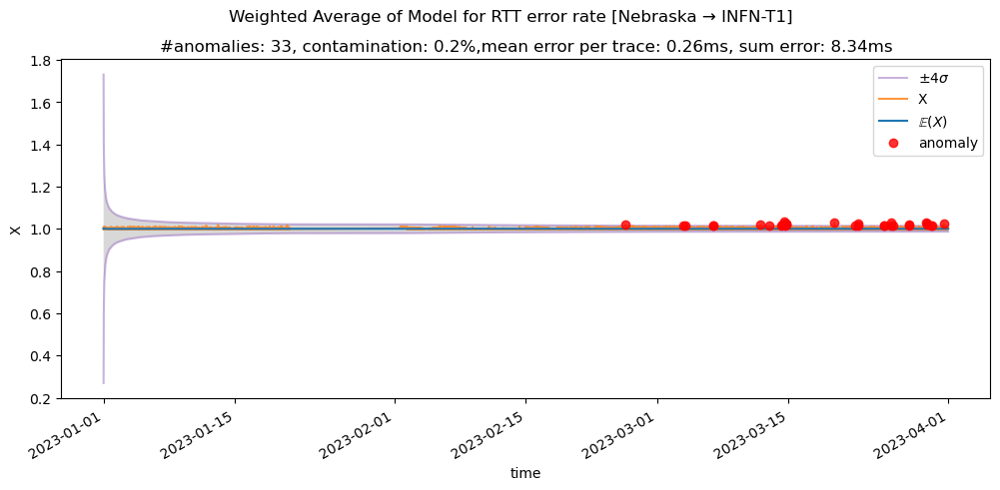

In [331]:
fig= plt.figure(figsize=(12, 5))
ax = plt.gca()
model.plot(ax = ax)
fig.suptitle(f"Weighted Average of Model for RTT error rate [{src_site} → {dest_site}]");
ax.set_title(f"#anomalies: {model.n_anomalies}, contamination: {100*model.n_anomalies/model.n:.1f}%," 
f"mean error per trace: {df[model.to_frame().anomalies]['sum_rtt_error'].mean():.2f}ms, "
f"sum error: {df[model.to_frame().anomalies]['sum_rtt_error'].sum():.2f}ms")
plt.show()


### Harmonic Mean of weights

In [332]:
model = NormalModel('a', 'b', one_sided=True, sigma_factor = 4, mu_0=1, sigma_0=1, alpha_0=1, beta_0=.1, gamma=0.7)
for i, x in rtt_anom_df['hmix'].items():
    model.log(i.timestamp()*1000, x)

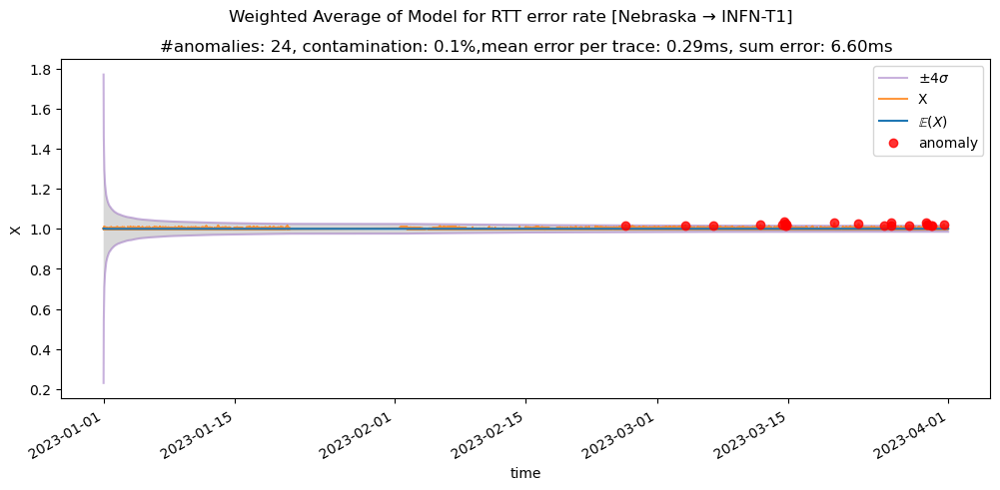

In [333]:
fig= plt.figure(figsize=(12, 5))
ax = plt.gca()
model.plot(ax = ax)
fig.suptitle(f"Weighted Average of Model for RTT error rate [{src_site} → {dest_site}]");
ax.set_title(f"#anomalies: {model.n_anomalies}, contamination: {100*model.n_anomalies/model.n:.1f}%," 
f"mean error per trace: {df[model.to_frame().anomalies]['sum_rtt_error'].mean():.2f}ms, "
f"sum error: {df[model.to_frame().anomalies]['sum_rtt_error'].sum():.2f}ms")
plt.show()

In [297]:
tmp = model.to_frame()[['observed', 'anomalies']]

In [298]:
rtt_dfs[sites] = tmp.copy()

In [299]:
(rtt_ipv6 if is_ipv6 else rtt_ipv4)[sites] = tmp

In [300]:
tmp['anoms'] = np.nan
tmp.loc[tmp['anomalies'],'anoms']=tmp.loc[tmp['anomalies']]['observed']

In [301]:
df['sum_rtt_error'] = df['rtt_error_diff'].apply(np.sum)

## interactive plot with real errors 

In [302]:
fig = go.Figure(data=[
    go.Scatter(x=tmp.index, y=tmp.observed, mode='lines', customdata=df['sum_rtt_error'], name="RTT error"),
    go.Scatter(x=tmp[tmp.anomalies].index, y=tmp[tmp.anomalies].observed, mode='markers', name="anomaly", customdata=df[tmp.anomalies]['sum_rtt_error'])],
    )
fig.update_traces(hovertemplate='Date:%{x}<br>value:%{y}<br>Time error:%{customdata:.2f}')

fig.update_layout(
    title=f"RTT errors on {dataset} [{'->'.join(list(stm.trace_models[sites].trace_models.keys())[ip_pair])}]<br>count:{df[tmp.anomalies].shape[0]}, mean:{df[tmp.anomalies]['sum_rtt_error'].mean():.2f}s, cumulative:{df[tmp.anomalies]['sum_rtt_error'].sum():.2f}s",
    xaxis_title="Date",
    yaxis_title="RTT error rate"
)

fig.show()

<Axes: >

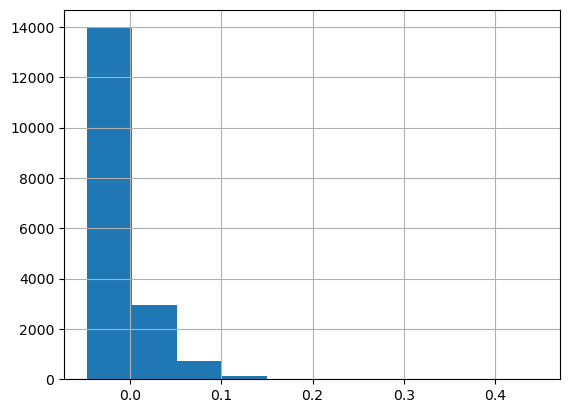

In [303]:
df['sum_rtt_error'].hist()

# TTL

I tried the same approach with TTL values

In [304]:
df['ttl_error_rate'] = df.apply(lambda row: calculate_error_rate(row['ttl_expected'], row['ttl_observed']), axis=1)
df['ttl_error_diff'] = df.apply(lambda row: calculate_error_difference(row['ttl_expected'], row['ttl_observed']), axis=1)

In [305]:
ttl_mean_z = []
ttl_anom_z = []
ttl_seq_z = []
ttl_hmix_z = []
ttl_mix_z = []

total_anoms = 1
index_cnt = defaultdict(lambda : 1)

for i, (ts, x) in tqdm(enumerate(df.iterrows()), total=df.shape[0]):
    anomalies = np.array(x['ttl_anoms'])
    
    anom_w = np.array(x['ttl_n_anoms'])
    anom_w = np.log1p(anom_w+1).astype(np.float64)
    anom_w /= anom_w.sum()

    uniform_w = np.ones(anomalies.shape[0])
    uniform_w /= np.sum(uniform_w)

    seq_w = calculate_seq_weights(anomalies)
    seq_w /= np.sum(seq_w)

    v = np.array(x['ttl_error_rate'])
    ttl_mean_z.append(v.mean())
    ttl_anom_z.append(v @ anom_w.T)
    ttl_seq_z.append(v @ seq_w.T)
    ttl_hmix_z.append(v @ hmean([uniform_w, anom_w, seq_w], axis=0).T)
    ttl_mix_z.append(v @ np.mean([uniform_w, anom_w, seq_w], axis=0).T)

100%|██████████| 17807/17807 [00:14<00:00, 1259.76it/s]


In [306]:
ttl_anom_df = pd.DataFrame(data=list(zip(ttl_mean_z, ttl_anom_z, ttl_seq_z ,ttl_hmix_z, ttl_mix_z)), index=df.index, columns=['mean', 'anom', 'seq', 'hmix', 'mix'])

In [307]:
fig = go.Figure(
    data=[
        go.Scatter(x=ttl_anom_df.index, y=ttl_anom_df[col], mode='lines',name=col) for col in ttl_anom_df.columns
        ]
)

fig.update_traces(hovertemplate='Date:%{x}<br>value:%{y}')

fig.update_layout(
    title=f"Weighted TTL errors on {dataset}",
    xaxis_title="Date",
    yaxis_title="TTL error rate",
)

fig.show()


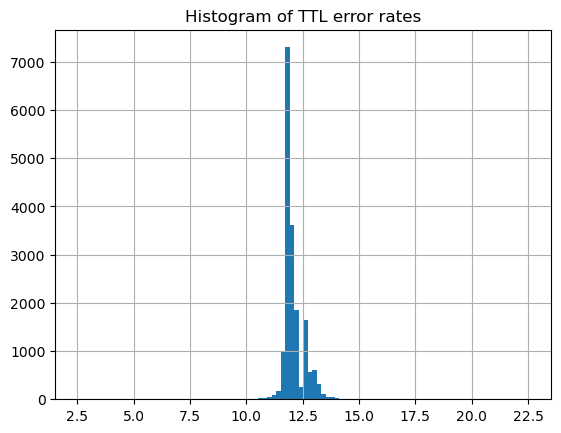

In [308]:
ax = df['ttl_error_rate'].apply(np.sum).hist(bins=100)
ax.set_title('Histogram of TTL error rates');

In [309]:
model = NormalModel('a', 'b', one_sided=True, gamma = 1, sigma_factor = 4, mu_0=1)
for i, x in ttl_anom_df['mix'].items():
    model.log(i.timestamp()*1000, x)

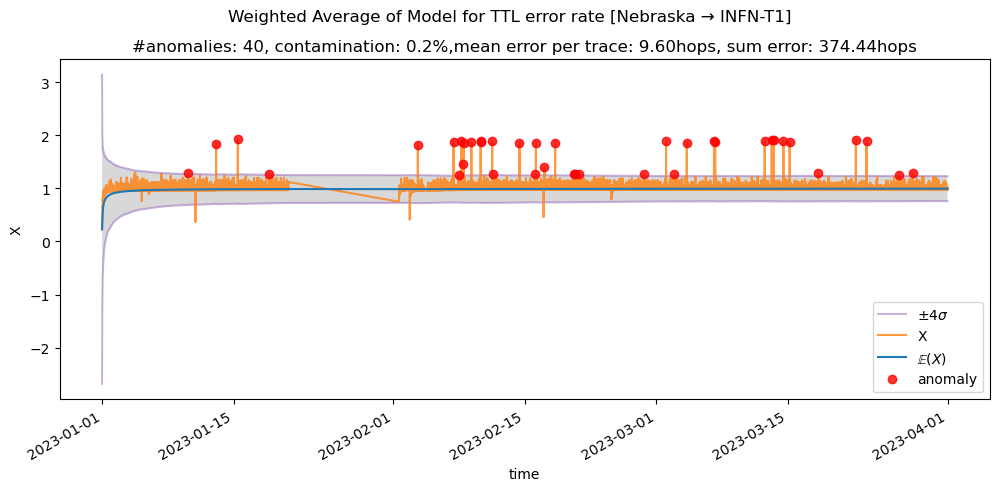

In [310]:
fig= plt.figure(figsize=(12, 5))
ax = plt.gca()
model.plot(ax = ax)
fig.suptitle(f"Weighted Average of Model for TTL error rate [{src_site} → {dest_site}]");
ax.set_title(f"#anomalies: {model.n_anomalies}, contamination: {100*model.n_anomalies/model.n:.1f}%," 
f"mean error per trace: {df[model.to_frame().anomalies]['ttl_error_diff'].apply(np.sum).mean():.2f}hops, "
f"sum error: {df[model.to_frame().anomalies]['ttl_error_diff'].apply(np.sum).sum():.2f}hops"
)
plt.show()

Text(0.5, 1.0, 'Histogram of TTL errors for detected records')

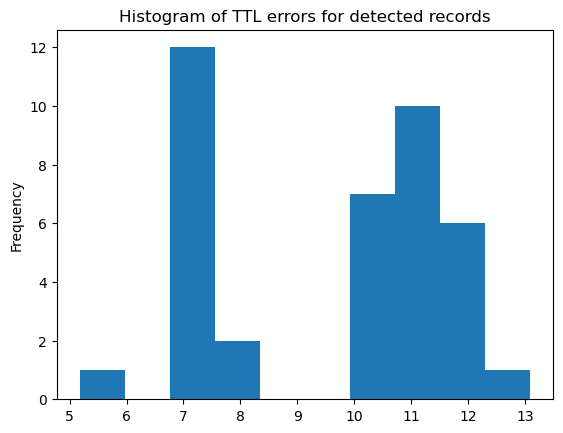

In [311]:
ax = df.loc[model.to_frame()['anomalies']]['ttl_error_diff'].apply(lambda x: np.sum(np.abs(x))).plot(kind='hist')
ax.set_title('Histogram of TTL errors for detected records')

In [312]:
tmp = model.to_frame()[['observed', 'anomalies']]


In [313]:
ttl_dfs[sites] = tmp

In [314]:
(ttl_ipv6 if is_ipv6 else ttl_ipv4)[sites] = tmp

In [315]:
tmp['anoms'] = np.nan
tmp.loc[tmp['anomalies'],'anoms']=tmp.loc[tmp['anomalies']]['observed']
df['ttl_error'] = df['ttl_error_diff'].apply(lambda x:np.sum(np.abs(x)))

### Interactive plot

In [123]:
fig = go.Figure(
    data=[
        go.Scatter(x=tmp.index, y=tmp.observed, mode='lines', customdata=df['ttl_error'], name="TTL error"),
        go.Scatter(x=tmp[tmp.anomalies].index, y=tmp[tmp.anomalies].observed, mode='markers', name="anomaly", customdata=df[tmp.anomalies]['ttl_error'])]
)

fig.update_traces(hovertemplate='Date:%{x}<br>value:%{y}<br>Hops error:%{customdata:.2f}')

fig.update_layout(
    title=f"TTL errors on {dataset} [{'->'.join(list(stm.trace_models[sites].trace_models.keys())[ip_pair])}] <br>count:{df[tmp.anomalies].shape[0]}, mean: {df[tmp.anomalies]['ttl_error'].mean():.2f} hops, cumulative: {df[tmp.anomalies]['ttl_error'].sum():.2f} hops",
    xaxis_title="Date",
    yaxis_title="TTL error rate",
)

fig.show()